## Jigsaw Multilingual Toxic Comment Classification
It only takes one toxic comment to sour an online discussion. The Conversation AI team, a research initiative founded by Jigsaw and Google, builds technology to protect voices in conversation. A main area of focus is machine learning models that can identify toxicity in online conversations, where toxicity is defined as anything rude, disrespectful or otherwise likely to make someone leave a discussion. If these toxic contributions can be identified, we could have a safer, more collaborative internet.

In the previous 2018 Toxic Comment Classification Challenge, Kagglers built multi-headed models to recognize toxicity and several subtypes of toxicity. In 2019, in the Unintended Bias in Toxicity Classification Challenge, you worked to build toxicity models that operate fairly across a diverse range of conversations. This year, we're taking advantage of Kaggle's new TPU support and challenging you to build multilingual models with English-only training data.

Jigsaw's API, Perspective, serves toxicity models and others in a growing set of languages (see our documentation for the full list). Over the past year, the field has seen impressive multilingual capabilities from the latest model innovations, including few- and zero-shot learning. We're excited to learn whether these results "translate" (pun intended!) to toxicity classification. Your training data will be the English data provided for our previous two competitions and your test data will be Wikipedia talk page comments in several different languages.

As our computing resources and modeling capabilities grow, so does our potential to support healthy conversations across the globe. Develop strategies to build effective multilingual models and you'll help Conversation AI and the entire industry realize that potential.

Disclaimer: The dataset for this competition contains text that may be considered profane, vulgar, or offensive.

### What am I predicting?
You are predicting the probability that a comment is toxic. A toxic comment would receive a 1.0. A benign, non-toxic comment would receive a 0.0. In the test set, all comments are classified as either a 1.0 or a 0.0.

### Files
jigsaw-toxic-comment-train.csv - data from our first competition. The dataset is made up of English comments from Wikipedia’s talk page edits.
jigsaw-unintended-bias-train.csv - data from our second competition. This is an expanded version of the Civil Comments dataset with a range of additional labels.
sample_submission.csv - a sample submission file in the correct format
test.csv - comments from Wikipedia talk pages in different non-English languages.
validation.csv - comments from Wikipedia talk pages in different non-English languages.
jigsaw-toxic-comment-train-processed-seqlen128.csv - training data preprocessed for BERT
jigsaw-unintended-bias-train-processed-seqlen128.csv - training data preprocessed for BERT
validation-processed-seqlen128.csv - validation data preprocessed for BERT
test-processed-seqlen128.csv - test data preprocessed for BERT
### Columns
id - identifier within each file.
comment_text - the text of the comment to be classified.
lang - the language of the comment.
toxic - whether or not the comment is classified as toxic. (Does not exist in test.csv.)

In [1]:
import time
start = time.perf_counter()
import tensorflow as tf
print(tf.__version__)
end = time.perf_counter()
print('Elapsed time: ' + str(end - start))

2.4.1
Elapsed time: 1.818012719999956


Mounting Google Drive

In [2]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [3]:
path = "/content/gdrive/MyDrive/Dataset/Jigsaw Multilingual Toxic Comment Classification/Data/"

<html>
    <p style='background:teal; color:coral; font-size:40px; padding:10px;text-align:center'><b>Read the dataset</b></p>
</html>

In [4]:
import pandas as pd
train_data = pd.read_csv(path+'jigsaw-toxic-comment-train.csv')
validation_data = pd.read_csv(path+'validation.csv')
test_data = pd.read_csv(path+'test.csv')

# EDA

In [5]:
"""
start = time.perf_counter()

#loading data if using local system
train_data = pd.read_csv("data/jigsaw-toxic-comment-train.csv")
validation_data = pd.read_csv("data/validation.csv")
test_data = pd.read_csv("data/test.csv")
end = time.perf_counter()
print('Elapsed time: ' + str(end - start))
"""

'\nstart = time.perf_counter()\n\n#loading data if using local system\ntrain_data = pd.read_csv("data/jigsaw-toxic-comment-train.csv")\nvalidation_data = pd.read_csv("data/validation.csv")\ntest_data = pd.read_csv("data/test.csv")\nend = time.perf_counter()\nprint(\'Elapsed time: \' + str(end - start))\n'

In [6]:
train_data.shape

(223549, 8)

In [7]:
train_data.head()

,id,comment_text,toxic,severe_toxic,obscene,threat,insult,identity_hate
0,0000997932d777bf,Explanation\nWhy the edits made under my usern...,0,0,0,0,0,0
1,000103f0d9cfb60f,D'aww! He matches this background colour I'm s...,0,0,0,0,0,0
2,000113f07ec002fd,"Hey man, I'm really not trying to edit war. It...",0,0,0,0,0,0
3,0001b41b1c6bb37e,"""\nMore\nI can't make any real suggestions on ...",0,0,0,0,0,0
4,0001d958c54c6e35,"You, sir, are my hero. Any chance you remember...",0,0,0,0,0,0


In [8]:
train_data.describe

<bound method NDFrame.describe of                       id  ... identity_hate
0       0000997932d777bf  ...             0
1       000103f0d9cfb60f  ...             0
2       000113f07ec002fd  ...             0
3       0001b41b1c6bb37e  ...             0
4       0001d958c54c6e35  ...             0
...                  ...  ...           ...
223544  fff8f64043129fa2  ...             0
223545  fff9d70fe0722906  ...             0
223546  fffa8a11c4378854  ...             0
223547  fffac2a094c8e0e2  ...             0
223548  fffb5451268fb5ba  ...             0

[223549 rows x 8 columns]>

In [9]:
validation_data.shape

(8000, 4)

In [10]:
validation_data.head()

,id,comment_text,lang,toxic
0,0,Este usuario ni siquiera llega al rango de ...,es,0
1,1,Il testo di questa voce pare esser scopiazzato...,it,0
2,2,Vale. Sólo expongo mi pasado. Todo tiempo pasa...,es,1
3,3,Bu maddenin alt başlığı olarak uluslararası i...,tr,0
4,4,Belçika nın şehirlerinin yanında ilçe ve belde...,tr,0


In [11]:
validation_data.describe

<bound method NDFrame.describe of         id                                       comment_text lang  toxic
0        0  Este usuario ni siquiera llega al rango de    ...   es      0
1        1  Il testo di questa voce pare esser scopiazzato...   it      0
2        2  Vale. Sólo expongo mi pasado. Todo tiempo pasa...   es      1
3        3  Bu maddenin alt başlığı olarak  uluslararası i...   tr      0
4        4  Belçika nın şehirlerinin yanında ilçe ve belde...   tr      0
...    ...                                                ...  ...    ...
7995  7995   Il fatto è che la pagina dei personaggi minor...   it      0
7996  7996  El imbesil ete dela luna no se entera ni ostia...   es      1
7997  7997  olum sız manyakmısınz siz adam sıze sanal yıld...   tr      1
7998  7998  El mapa del reinado de Alhaken esta ligerament...   es      0
7999  7999  lasciami la tua email per favore. ad ogni modo...   it      0

[8000 rows x 4 columns]>

In [12]:
test_data.head

<bound method NDFrame.head of           id                                            content lang
0          0  Doctor Who adlı viki başlığına 12. doctor olar...   tr
1          1   Вполне возможно, но я пока не вижу необходимо...   ru
2          2  Quindi tu sei uno di quelli   conservativi  , ...   it
3          3  Malesef gerçekleştirilmedi ancak şöyle bir şey...   tr
4          4  :Resim:Seldabagcan.jpg resminde kaynak sorunu ...   tr
...      ...                                                ...  ...
63807  63807  No, non risponderò, come preannunciato. Prefer...   it
63808  63808  Ciao, I tecnici della Wikimedia Foundation sta...   it
63809  63809  innnazitutto ti ringrazio per i ringraziamenti...   it
63810  63810   Kaç olumlu oy gerekiyor? Şu an 7 oldu.  Hayır...   tr
63811  63811   Te pido disculpas. La verdad es que no me per...   es

[63812 rows x 3 columns]>

In [13]:
test_data.shape

(63812, 3)

In [14]:
test_data.describe

<bound method NDFrame.describe of           id                                            content lang
0          0  Doctor Who adlı viki başlığına 12. doctor olar...   tr
1          1   Вполне возможно, но я пока не вижу необходимо...   ru
2          2  Quindi tu sei uno di quelli   conservativi  , ...   it
3          3  Malesef gerçekleştirilmedi ancak şöyle bir şey...   tr
4          4  :Resim:Seldabagcan.jpg resminde kaynak sorunu ...   tr
...      ...                                                ...  ...
63807  63807  No, non risponderò, come preannunciato. Prefer...   it
63808  63808  Ciao, I tecnici della Wikimedia Foundation sta...   it
63809  63809  innnazitutto ti ringrazio per i ringraziamenti...   it
63810  63810   Kaç olumlu oy gerekiyor? Şu an 7 oldu.  Hayır...   tr
63811  63811   Te pido disculpas. La verdad es que no me per...   es

[63812 rows x 3 columns]>

In [15]:
pip install wordcloud

In [16]:
pip install plotly

In [17]:
from wordcloud import WordCloud
import plotly.express as px

start = time.perf_counter()
def nonan(x):
    if type(x) == str:
        return x.replace("\n", "")
    else:
        return ""

text = ' '.join([nonan(abstract) for abstract in train_data["comment_text"]])
wordcloud = WordCloud(max_font_size=None, background_color='white', collocations=False,
                      width=1200, height=1000).generate(text)

end = time.perf_counter()
print('Elapsed time: ' + str(end - start))
fig = px.imshow(wordcloud)
fig.update_layout(title_text='Common words in comments')

Elapsed time: 21.610492377999947


In [18]:
start = time.perf_counter()
wordcloud = WordCloud(max_font_size=None, background_color='red', collocations=False,
                      width=1200, height=1000).generate(text)
fig = px.imshow(wordcloud)
fig.update_layout(title_text='Common words in comments')

#end = time.perf_counter()
#print('Elapsed time: ' + str(end - start))

In [19]:
train = train_data
test = test_data
validation = validation_data
#delete when no longer needed
del train_data
del test_data
del validation_data

In [20]:
import gc
#collect residual garbage
gc.collect()

100

In [21]:
train

,id,comment_text,toxic,severe_toxic,obscene,threat,insult,identity_hate
0,0000997932d777bf,Explanation\nWhy the edits made under my usern...,0,0,0,0,0,0
1,000103f0d9cfb60f,D'aww! He matches this background colour I'm s...,0,0,0,0,0,0
2,000113f07ec002fd,"Hey man, I'm really not trying to edit war. It...",0,0,0,0,0,0
3,0001b41b1c6bb37e,"""\nMore\nI can't make any real suggestions on ...",0,0,0,0,0,0
4,0001d958c54c6e35,"You, sir, are my hero. Any chance you remember...",0,0,0,0,0,0
...,...,...,...,...,...,...,...,...
223544,fff8f64043129fa2,":Jerome, I see you never got around to this…! ...",0,0,0,0,0,0
223545,fff9d70fe0722906,==Lucky bastard== \n http://wikimediafoundatio...,0,0,0,0,0,0
223546,fffa8a11c4378854,==shame on you all!!!== \n\n You want to speak...,0,0,0,0,0,0
223547,fffac2a094c8e0e2,MEL GIBSON IS A NAZI BITCH WHO MAKES SHITTY MO...,1,0,1,0,1,0


Visualizing 
https://stackoverflow.com/questions/31632637/label-axes-on-seaborn-barplot

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



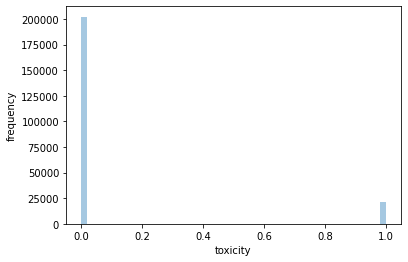

In [22]:
import pandas as pd
import seaborn as sb
from matplotlib import pyplot as plt
axis = sb.distplot(train['toxic'],kde = False)
axis.set(xlabel='toxicity', ylabel='frequency')
plt.show()

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



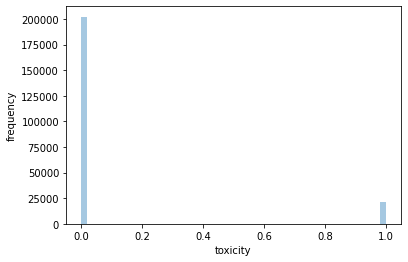

In [23]:
axis = sb.distplot(train['toxic'],kde = False)
axis.set(xlabel='toxicity', ylabel='frequency')
plt.show()

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



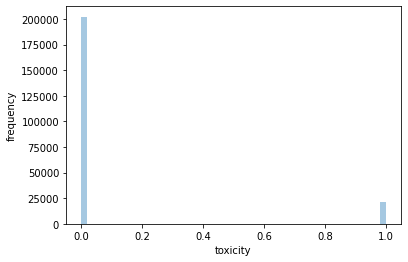

In [24]:
axis = sb.distplot(train['toxic'],kde = False)
axis.set(xlabel='toxicity', ylabel='frequency')
plt.show()

### Cleaing Text

In [25]:
#checking 

In [26]:
#installing tweet-preprocessor
!pip install tweet-preprocessor
import preprocessor as p
p.set_options(p.OPT.URL,p.OPT.MENTION, p.OPT.SMILEY,p.OPT.EMOJI)

In [37]:
# Remove usernames and links
import re
"""
train = train_data
test = test_data
validation = validation_data
#delete when no longer needed
del train_data
del test_data
del validation_data
#collect residual garbage
gc.collect()
"""


import pandas as pd
import numpy as np
def clean_text(text):
    #print(type(text))
    #text1 = text
    #clean using tweet preprocessor
    #text = text.map([p.clean(x) for x in text1])
    #print(type(text))
    #print(text)
    # fill the missing entries and convert them to lower case
    text = text.fillna("fillna").str.lower()
    # replace the newline characters with space 
    text = text.map(lambda x: re.sub('\\n',' ',str(x)))
    text = text.map(lambda x: re.sub("\[\[User.*",'',str(x)))
    # remove usernames and links
    text = text.map(lambda x: re.sub("\d{1,3}\.\d{1,3}\.\d{1,3}\.\d{1,3}",'',str(x)))
    text = text.map(lambda x: re.sub("\(http://.*?\s\(http://.*\)",'',str(x)))
    return text

"""
# initialize list of lists
data = [['Subham http:\\subham.com www.s.com']]
# Create the pandas DataFrame
df = pd.DataFrame(data, columns = ['Comment'])

# simple array
data = np.array(['Subham http:\\subham.com www.s.com','subham #qw'])
  
ser = pd.Series(data)
print(clean_text(ser))
"""
#print(train.index)
start = time.perf_counter()
train["comment_text"] = clean_text(train["comment_text"])
end = time.perf_counter()
print('Elapsed time: ' + str(end - start))


start = time.perf_counter()
test["content"] = clean_text(test["content"])
end = time.perf_counter()
print('Elapsed time: ' + str(end - start))

start = time.perf_counter()
validation["comment_text"] = clean_text(validation["comment_text"])
end = time.perf_counter()
print('Elapsed time: ' + str(end - start))

Elapsed time: 1.2805981979998933
Elapsed time: 1.2314238820000583
Elapsed time: 0.154569676000051


In [42]:
p = re.compile('#*')
train[‘hashtag’] = train[‘comment_text’].apply(lambda x: p.findall(r”#(\w+)”, x))

SyntaxError: ignored

In [45]:
import re

# '*' replaces the no. of occurrence of a character.
p = re.compile('#*')
print(p.findall("#ab nd"))

['#', '', '', '', '', '', '']


Hashtags are manytimes used to represent emotions nowadays, so taking it as separate feature.

In [ ]:
#take hashtag as separate feature
train[‘hashtag’] = train[‘comment_text’].apply(lambda x: re.findall(r”#(\w+)”, x))
test[‘hashtag’] = test[‘comment_text’].apply(lambda x: re.findall(r”#(\w+)”, x))

In [ ]:
from nltk.corpus import stopwords
nltk.download('wordnet')
nltk.download('stopwords')
#stop word removal
stop_words = set(stopwords.words('english'))
tweets['comment_text'] = tweets['comment_text'].apply(lambda x: [item for item in \ 
                         x if item not in stop_words])


In [ ]:
train_data.head()

In [ ]:
validation_data.head()

In [ ]:
test_data.head()